# Evaluating Local Expainability

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
from utils import make_test_set_esnli, make_test_set_mnli, make_test_set_cose
from model import ModelNLI, ModelZSC
from explainer import Explainer

In [4]:
# number of explanations
NUM_EXPL = 5

#importing dataset
dataset_esnli = make_test_set_esnli(size=NUM_EXPL, remove_bad_explanations=True) # 9830 is dev size esnli (originally 9842 but 12 instance are wrongly annotated)
dataset_mnli = make_test_set_mnli(size=NUM_EXPL) # 9815 is dev size mnli
dataset_cose = make_test_set_cose(size=NUM_EXPL, remove_bad_explanations=True) # 718 (originally 1221 is dev size cose but 503 instances have bad explanations, i.e. the whole question highlighted))

Found cached dataset multi_nli (/Users/henningheyen/.cache/huggingface/datasets/multi_nli/default/0.0.0/591f72eb6263d1ab527561777936b199b714cda156d35716881158a2bd144f39)


  0%|          | 0/3 [00:00<?, ?it/s]

Found cached dataset cos_e (/Users/henningheyen/.cache/huggingface/datasets/cos_e/v1.11/1.11.0/e8dc57a5b321a2a97063efb8d316d6d8a0d9a2d3a392dafc913e55bed42736d2)


  0%|          | 0/2 [00:00<?, ?it/s]

In [5]:
avg_len_esnli

NameError: name 'avg_len_esnli' is not defined

In [ ]:
#calculating average explanation length per dataset
import numpy as np

full_dataset_mnli = make_test_set_mnli(size=9815) # 9815 is dev size mnli
full_dataset_esnli = make_test_set_esnli(size=9830, remove_bad_explanations=True) # 9830 is dev size esnli (originally 9842 but 12 instance are wrongly annotated)
full_dataset_cose = make_test_set_cose(size=718, remove_bad_explanations=True) # 718 (originally 1221 is dev size cose but 503 instances have bad explanations, i.e. the whole question highlighted))

len_mnli = [len(full_dataset_mnli['sentence_pairs'][i][0].split())+len(full_dataset_mnli['sentence_pairs'][i][1].split()) for i in range(9815)]
len_esnli = [len(full_dataset_esnli['sentence_pairs'][i][0].split())+len(full_dataset_esnli['sentence_pairs'][i][1].split()) for i in range(9830)]
len_cose = [len(full_dataset_cose['question'][i].split()) for i in range(718)]

avg_len_mnli = np.mean(len_mnli)
avg_len_esnli = np.mean(len_esnli)
avg_len_cose = np.mean(len_cose)

ratios_esnli = [len(full_dataset_esnli['extractive_explanation'][i])/len_esnli[i] for i in range(9830)]
ratios_cose = [len(full_dataset_cose['extractive_explanation'][i])/len_cose[i] for i in range(718)]

avg_ratio_esnli = np.mean(ratios_esnli)
avg_ratio_cose = np.mean(ratios_cose)

print(f'average input length MNLI: {round(avg_len_mnli,3)} +- {round(np.std(len_mnli),3)}')
print(f'average input length e-SNLI: {round(avg_len_esnli,3)} +- {round(np.std(len_esnli),3)}')
print(f'average input length CoS-e: {round(avg_len_cose,3)} +- {round(np.std(len_cose),3)}')

print(f'average explanation input ratio e-SNLI: {round(avg_ratio_esnli,3)} +- {round(np.std(ratios_esnli),3)}')
print(f'average explanation input ratio CoS-e: {round(avg_ratio_cose,3)} +- {round(np.std(ratios_cose),3)}')

Found cached dataset multi_nli (/Users/henningheyen/.cache/huggingface/datasets/multi_nli/default/0.0.0/591f72eb6263d1ab527561777936b199b714cda156d35716881158a2bd144f39)


  0%|          | 0/3 [00:00<?, ?it/s]

Found cached dataset cos_e (/Users/henningheyen/.cache/huggingface/datasets/cos_e/v1.11/1.11.0/e8dc57a5b321a2a97063efb8d316d6d8a0d9a2d3a392dafc913e55bed42736d2)


  0%|          | 0/2 [00:00<?, ?it/s]

average input length MNLI: 29.182 +- 16.267
average input length e-SNLI: 21.45 +- 7.528
average input length CoS-e: 13.131 +- 5.232
average explanation input ratio e-SNLI: 0.199 +- 0.137
average explanation input ratio CoS-e: 0.261 +- 0.193


# Natural Language Inference

In [ ]:
# Natural Language Inference
xsmall_nli = ModelNLI(model_name='cross-encoder/nli-deberta-v3-xsmall')
small_nli = ModelNLI(model_name='cross-encoder/nli-deberta-v3-small')
base_nli = ModelNLI(model_name='cross-encoder/nli-deberta-v3-base')
large_nli = ModelNLI(model_name='cross-encoder/nli-deberta-v3-large')

models_nli = [
    xsmall_nli,
    small_nli,
    base_nli,
    large_nli
]

model_names_nli = [
    'xsmall_nli',
    'small_nli',
    'base_nli',
    'large_nli'
]


In [ ]:
explainer = Explainer(class_names=['contradiction', 'entailment', 'neutral'])

### MNLI

In [9]:
%%time

# Computing LIME explanations on xsmall
explanations_xsmall_mnli = explainer.compute_explanations(
    sentences = dataset_mnli['sentence_pairs'],
    model=xsmall_nli,
    num_samples=100,
    task='NLI',
    )

CPU times: user 39.8 s, sys: 3.85 s, total: 43.7 s
Wall time: 40.8 s


In [10]:
%%time

# Computing LIME explanations on small
explanations_small_mnli = explainer.compute_explanations(
    sentences = dataset_mnli['sentence_pairs'],
    model=small_nli,
    num_samples=100,
    task='NLI',
    )

CPU times: user 1min 4s, sys: 11.2 s, total: 1min 15s
Wall time: 1min 12s


In [11]:
%%time

# Computing LIME explanations on base
explanations_base_mnli = explainer.compute_explanations(
    sentences = dataset_mnli['sentence_pairs'],
    model=base_nli,
    num_samples=100,
    task='NLI',
    )

CPU times: user 2min 10s, sys: 21.3 s, total: 2min 31s
Wall time: 2min 21s


In [12]:
%%time

# Computing LIME explanations on large
explanations_large_mnli = explainer.compute_explanations(
    sentences = dataset_mnli['sentence_pairs'],
    model=large_nli,
    num_samples=100,
    task='NLI',
    )

CPU times: user 7min 17s, sys: 1min 8s, total: 8min 25s
Wall time: 8min 9s


In [13]:
explanations_mnli = [
    explanations_xsmall_mnli,
    explanations_small_mnli,
    explanations_base_mnli,
    explanations_large_mnli,
    ]

#### Intuition

In [14]:
# Plotting LIME highlights
explainer.show_lime(explanations_xsmall_mnli[2:3])

----------------------------------------------------------------------------------------------------


In [15]:
explainer.show_lime(explanations_small_mnli[2:3])

----------------------------------------------------------------------------------------------------


In [16]:
explainer.show_lime(explanations_base_mnli[2:3])

----------------------------------------------------------------------------------------------------


In [17]:
explainer.show_lime(explanations_large_mnli[2:3])

----------------------------------------------------------------------------------------------------


## Faithfulness (Comprehensiveness and Sufficiency)

In [16]:
# Calculating Comprehensiveness using top 50% most important tokens 
for i, model in enumerate(models):
    print('-'*50, f'Model: {model_names[i]}', '-'*50)    
    explainer.comprehensiveness(
        explanation=explanations_mnli[i][2], 
        sentence=dataset_mnli['sentence_pairs'][2], 
        predict=model.predict, 
        #top_k=10,
        top_percent=0.1,
        verbose=True,
        task='NLI'
        )
    print()

-------------------------------------------------- Model: xsmall --------------------------------------------------
explanation_tokens:  ['in', 'peaceful', 'of']
sentence_old:  ('He unleashed a 16-day reign of terror that left 300 Madeirans dead, stocks of sugar destroyed, and the island plundered.', 'He unleashed a large debate over the 16-day reign that ended in a peaceful protest.')
sentence_new:  He unleashed a 16-day reign terror that left 300 Madeirans dead, stocks sugar destroyed, and the island plundered. [SEP] He unleashed a large debate over the 16-day reign that ended a protest.
probability_old:  0.9796936
predicted_label_old:  contradiction
probability_new:  0.88178986
predicted_label_new:  contradiction
comprehensiveness:  0.09790373 


-------------------------------------------------- Model: small --------------------------------------------------
explanation_tokens:  ['terror', 'debate', 'peaceful']
sentence_old:  ('He unleashed a 16-day reign of terror that left 300 Ma

In [17]:
# Calculating Sufficiency using top 50% most important tokens 

for i, model in enumerate(models):
    print('-'*50, f'Model: {model_names[i]}', '-'*50)    
    explainer.sufficiency(
        explanation=explanations_mnli[i][2], 
        sentence=dataset_mnli['sentence_pairs'][2], 
        predict=model.predict, 
        #top_k=10,
        top_percent=0.1,
        verbose=True,
        task='NLI',
        )
    print()



-------------------------------------------------- Model: xsmall --------------------------------------------------
explanation_tokens:  ['in', 'peaceful', 'of']
sentence_old:  ('He unleashed a 16-day reign of terror that left 300 Madeirans dead, stocks of sugar destroyed, and the island plundered.', 'He unleashed a large debate over the 16-day reign that ended in a peaceful protest.')
sentence_new:  of of [SEP] in peaceful
probability_old:  0.9796936
predicted_label_old:  contradiction
probability_new:  0.11598557
predicted_label_new:  neutral
sufficiency:  0.863708 


-------------------------------------------------- Model: small --------------------------------------------------
explanation_tokens:  ['terror', 'debate', 'peaceful']
sentence_old:  ('He unleashed a 16-day reign of terror that left 300 Madeirans dead, stocks of sugar destroyed, and the island plundered.', 'He unleashed a large debate over the 16-day reign that ended in a peaceful protest.')
sentence_new:  terror [SEP]

#### e-SNLI

In [18]:
explainer = Explainer(class_names=['contradiction', 'entailment', 'neutral'])

In [19]:
%%time

# Computing LIME explanations on xsmall
explanations_xsmall_esnli = explainer.compute_explanations(
    sentences = dataset_esnli['sentence_pairs'],
    model=xsmall_nli,
    num_samples=100,
    task='NLI',
    )

CPU times: user 31.1 s, sys: 8.4 s, total: 39.5 s
Wall time: 38.7 s


In [20]:
%%time

# Computing LIME explanations on small
explanations_small_esnli = explainer.compute_explanations(
    sentences = dataset_esnli['sentence_pairs'],
    model=small_nli,
    num_samples=100,
    task='NLI',
    )

CPU times: user 55.7 s, sys: 17.3 s, total: 1min 12s
Wall time: 1min 19s


In [21]:
%%time

# Computing LIME explanations on base
explanations_base_esnli = explainer.compute_explanations(
    sentences = dataset_esnli['sentence_pairs'],
    model=base_nli,
    num_samples=100,
    task='NLI',
    )

CPU times: user 1min 49s, sys: 31.1 s, total: 2min 20s
Wall time: 2min 28s


In [22]:
%%time

# Computing LIME explanations on large
explanations_large_esnli = explainer.compute_explanations(
    sentences = dataset_esnli['sentence_pairs'],
    model=large_nli,
    num_samples=100,
    task='NLI',
    )


CPU times: user 5min 56s, sys: 1min 24s, total: 7min 20s
Wall time: 7min 43s


In [23]:
explanations_esnli = [
    explanations_xsmall_esnli,
    explanations_small_esnli,
    explanations_base_esnli,
    explanations_large_esnli,
    ]

further analysis could be made here on MNLI

## Plausibilty

#### e-SNLI

In [20]:
index = 2

print('sentence pair: ', dataset_esnli['sentence_pairs'][index])
print('true label: ', dataset_esnli['test_labels_text'][index])
print('premise with highlights: ',dataset_esnli['sentence1_marked'][index])
print('hypothesis with highlights: ', dataset_esnli['sentence2_marked'][index])
print('extractive_explanation: ', dataset_esnli['extractive_explanation'][index])

sentence pair:  ('A crowd of people are standing against a railing.', 'The people are all sitting.')
true label:  contradiction
premise with highlights:  A crowd of people are *standing* against a railing.
hypothesis with highlights:  The people are all *sitting.*
extractive_explanation:  ['standing', 'sitting.']


In [21]:
xsmall.predict([dataset_esnli['sentence_pairs'][index]]) # 0: contradiction, 1: entailment, 2: neutral 

array([[9.9835891e-01, 4.9278233e-04, 1.1482839e-03]], dtype=float32)

In [22]:
explainer.show_lime([explanations_xsmall_esnli[index]])

----------------------------------------------------------------------------------------------------


In [23]:
explainer.get_explanation_list([explanations_xsmall_esnli[index]], top_percent=avg_len_esnli)

[['sitting.', 'railing.', 'A']]

In [24]:
index = 1

ground_truth_list = dataset_esnli['extractive_explanation']
explanation_tokens_list = explainer.get_explanation_list(explanations_xsmall_esnli, top_k=None, top_percent=avg_len_esnli)

print('ground truth explanation: ', ground_truth_list[index])
print('LIME explanation: ', explanation_tokens_list[index])

iou_example = explainer.compute_instance_iou(explanation_tokens_list[index], ground_truth_list[index])
tokenf1_example = explainer.compute_instance_f1(explanation_tokens_list[index], ground_truth_list[index])

print('iou_example: ', iou_example)
print('tokenf1_example: ', tokenf1_example)

ground truth explanation:  ['trouble,', 'asleep.', 'looks']
LIME explanation:  ['asleep.', 'trouble,', 'safe', 'is', 'her', 'in']
iou_example:  0.2857142857142857
tokenf1_example:  0.4444444444444444


In [25]:
# across mustiple explanations:
iou_macro = explainer.compute_macro_iou(explanation_tokens_list, ground_truth_list)
tokenf1_macro = explainer.compute_macro_f1(explanation_tokens_list, ground_truth_list)

print(f'macro_iou for {NUM_EXPL} number of explanations: ', iou_macro)
print(f'macro_f1 for {NUM_EXPL} number of explanations: ', tokenf1_macro)

macro_iou for 5 number of explanations:  0.19714285714285715
macro_f1 for 5 number of explanations:  0.3155555555555555


# Zero Shot Classification

In [31]:
# Zero Shot Classification
xsmall_zsc = ModelZSC(model_name='cross-encoder/nli-deberta-v3-xsmall')
small_zsc = ModelZSC(model_name='cross-encoder/nli-deberta-v3-small')
base_zsc = ModelZSC(model_name='cross-encoder/nli-deberta-v3-base')
large_zsc = ModelZSC(model_name='cross-encoder/nli-deberta-v3-large')

models_zsc = [
    xsmall_zsc,
    small_zsc,
    base_zsc,
    large_zsc,
]

model_names_zsc = [
    'xsmall_zsc',
    'small_zsc',
    'base_zsc',
    'large_zsc',
]

In [32]:
# no class names becuase of zero shot classification setting
explainer = Explainer()

#### CoS-e

In [27]:
%%time

# Computing LIME explanations on xsmall
explanations_xsmall_cose = explainer.compute_explanations(
   sentences = dataset_cose['question'],
   model=xsmall_zsc,
   num_samples=100,
   class_names_list=dataset_cose['candidate_labels_list']
   )

CPU times: user 5min 18s, sys: 4.98 s, total: 5min 23s
Wall time: 5min 23s


In [28]:
%%time

# Computing LIME explanations on small
explanations_small_cose = explainer.compute_explanations(
   sentences = dataset_cose['question'],
   model=small_zsc,
   num_samples=100,
   class_names_list=dataset_cose['candidate_labels_list']
   )

CPU times: user 11min 22s, sys: 11.1 s, total: 11min 33s
Wall time: 11min 44s


In [29]:
%%time

# Computing LIME explanations on base
explanations_base_cose = explainer.compute_explanations(
   sentences = dataset_cose['question'],
   model=base_zsc,
   num_samples=100,
   class_names_list=dataset_cose['candidate_labels_list']
   )

CPU times: user 25min 48s, sys: 43.2 s, total: 26min 31s
Wall time: 27min 17s


In [34]:
%%time

# Computing LIME explanations on large
explanations_large_cose = explainer.compute_explanations(
   sentences = dataset_cose['question'],
   model=large_zsc,
   num_samples=100,
   class_names_list=dataset_cose['candidate_labels_list']
   )

KeyboardInterrupt: 

In [ ]:
explanations_cose = [
    explanations_xsmall_cose,
    explanations_small_cose,
    explanations_base_cose,
    explanations_large_cose,
    ]

NameError: name 'explanations_large_cose' is not defined

In [29]:
result_xsmall = xsmall.get_results(dataset_cose['question'], candidate_labels_list=dataset_cose['candidate_labels_list'])
print(dataset_cose['answer'])
result_xsmall


['chemistry lab', 'class', 'desk drawer', 'exit ramp', 'lots of attention']


[{'sequence': 'Where would a person light alcohol on fire to observe the reaction?',
  'labels': ['bar', 'pub', 'chemistry lab', 'restaurants', 'supermarket'],
  'scores': [0.3450700342655182,
   0.3242831826210022,
   0.13882951438426971,
   0.11389652639627457,
   0.07792072743177414]},
 {'sequence': 'Making a schedule was easy to pick, the major called for knowledge that required a certain what?',
  'labels': ['meeting', 'class', 'university', 'encyclopedia', 'color'],
  'scores': [0.4930911064147949,
   0.19443699717521667,
   0.18845981359481812,
   0.08616605401039124,
   0.03784600645303726]},
 {'sequence': 'Dad wanted to hide the check in his office, where did he put it?',
  'labels': ['bank',
   'pay envelope',
   'desk drawer',
   'cash register',
   'fish tank'],
  'scores': [0.43714067339897156,
   0.3397791385650635,
   0.09931384772062302,
   0.09002693742513657,
   0.03373938053846359]},
 {'sequence': 'How might a automobile get off a freeway?',
  'labels': ['exit ramp',

In [30]:
# xsmall example on CoS-e
explainer.show_lime(explanations_cose[0][1:2])

----------------------------------------------------------------------------------------------------


In [31]:
explainer.show_lime(explanations_cose[1][1:2])

----------------------------------------------------------------------------------------------------


In [32]:
explainer.show_lime(explanations_cose[2][1:2])

----------------------------------------------------------------------------------------------------


In [33]:
explainer.show_lime(explanations_cose[3][1:2])

----------------------------------------------------------------------------------------------------


In [34]:
dataset_cose['candidate_labels_list'][1]

['color', 'class', 'meeting', 'university', 'encyclopedia']

In [35]:
explainer.show_lime(explanations_cose[0][1:2])

----------------------------------------------------------------------------------------------------


In [36]:
dataset_cose['choices'][1]

['color', 'class', 'meeting', 'university', 'encyclopedia']

In [37]:
result_xsmall = xsmall.get_results(["Dan was a with just one heifer. But that was okay, he only kept her for milk, and he didn't think he'd find good farmland in a place as cold as where?"], candidate_labels_list=[['arizona', 'farm yard', 'michigan', 'german field', 'dairy farm']])
result_xsmall


[{'sequence': "Dan was a with just one heifer. But that was okay, he only kept her for milk, and he didn't think he'd find good farmland in a place as cold as where?",
  'labels': ['dairy farm', 'farm yard', 'german field', 'michigan', 'arizona'],
  'scores': [0.9171769618988037,
   0.056530870497226715,
   0.010912119410932064,
   0.00802537240087986,
   0.0073547023348510265]}]

In [38]:
explainer.show_lime([explanations_cose[0][2]])

----------------------------------------------------------------------------------------------------


## Faithfulness

In [39]:
index = 1

# Calculating Comprehensiveness using top 50% most important tokens 
for i, model in enumerate(models):
    print('-'*50, f'Model: {model_names[i]}', '-'*50)    
    explainer.comprehensiveness(
        explanation=explanations_cose[i][index], 
        sentence=dataset_cose['question'][index], 
        predict=model.predict,
        #top_k=10,
        top_percent=0.1,
        verbose=True,
        task='ZSC',
        candidate_labels=dataset_cose['candidate_labels_list'][index]
        )
    print()

-------------------------------------------------- Model: xsmall --------------------------------------------------
explanation_tokens:  ['schedule', 'was']
sentence_old:  Making a schedule was easy to pick, the major called for knowledge that required a certain what?
sentence_new:  Making a easy to pick, the major called for knowledge that required a certain what?
probability_old:  0.4930911064147949
predicted_label_old:  meeting
probability_new:  0.25623947381973267
predicted_label_new:  class
comprehensiveness:  0.23685163259506226 


-------------------------------------------------- Model: small --------------------------------------------------
explanation_tokens:  ['schedule', 'what?']
sentence_old:  Making a schedule was easy to pick, the major called for knowledge that required a certain what?
sentence_new:  Making a was easy to pick, the major called for knowledge that required a certain
probability_old:  0.32904306054115295
predicted_label_old:  meeting
probability_new:  0.2

In [40]:
index = 1

# Calculating Comprehensiveness using top 50% most important tokens 
for i, model in enumerate(models):
    print('-'*50, f'Model: {model_names[i]}', '-'*50)    
    explainer.sufficiency(
        explanation=explanations_cose[i][index], 
        sentence=dataset_cose['question'][index], 
        predict=model.predict,
        #top_k=10,
        top_percent=0.1,
        verbose=True,
        task='ZSC',
        candidate_labels=dataset_cose['candidate_labels_list'][index]
        )
    print()

-------------------------------------------------- Model: xsmall --------------------------------------------------
explanation_tokens:  ['schedule', 'was']
sentence_old:  Making a schedule was easy to pick, the major called for knowledge that required a certain what?
sentence_new:  schedule was
probability_old:  0.4930911064147949
predicted_label_old:  meeting
probability_new:  0.6543315649032593
predicted_label_new:  meeting
sufficiency:  -0.16124045848846436 


-------------------------------------------------- Model: small --------------------------------------------------
explanation_tokens:  ['schedule', 'what?']
sentence_old:  Making a schedule was easy to pick, the major called for knowledge that required a certain what?
sentence_new:  schedule what?
probability_old:  0.32904306054115295
predicted_label_old:  meeting
probability_new:  0.6719583868980408
predicted_label_new:  meeting
sufficiency:  -0.3429153263568878 


-------------------------------------------------- Model: b

## Plausibility

#### CoS-e

In [41]:
index = 0
print('question: ', dataset_cose['question'][index])
print('choices: ', dataset_cose['choices'][index])
print('answer: ', dataset_cose['answer'][index])
print('extractive_explanation: ', dataset_cose['extractive_explanation'][index])
print()

question:  Where would a person light alcohol on fire to observe the reaction?
choices:  ['supermarket', 'bar', 'pub', 'restaurants', 'chemistry lab']
answer:  chemistry lab
extractive_explanation:  ['alcohol', 'on', 'fire']



In [42]:
xsmall.get_results([dataset_cose['question'][index]], candidate_labels_list=[dataset_cose['candidate_labels_list'][index]])

[{'sequence': 'Where would a person light alcohol on fire to observe the reaction?',
  'labels': ['bar', 'pub', 'chemistry lab', 'restaurants', 'supermarket'],
  'scores': [0.3450700342655182,
   0.3242831826210022,
   0.13882951438426971,
   0.11389652639627457,
   0.07792072743177414]}]

In [43]:
explainer.get_explanation_list([explanations_cose[0][index]], top_percent=avg_len_cose)

[['alcohol', 'person', 'fire', 'observe']]

In [44]:
index = 0

ground_truth_list = dataset_cose['extractive_explanation']
explanation_tokens_list = explainer.get_explanation_list(explanations_cose[0], top_k=None, top_percent=avg_len_cose)

print('ground truth explanation: ', ground_truth_list[index])
print('LIME explanation: ', explanation_tokens_list[index])

iou_example = explainer.compute_instance_iou(explanation_tokens_list[index], ground_truth_list[index])
tokenf1_example = explainer.compute_instance_f1(explanation_tokens_list[index], ground_truth_list[index])

print('iou_example: ', iou_example)
print('tokenf1_example: ', tokenf1_example)

ground truth explanation:  ['alcohol', 'on', 'fire']
LIME explanation:  ['alcohol', 'person', 'fire', 'observe']
iou_example:  0.4
tokenf1_example:  0.5714285714285715


In [45]:
# across mustiple explanations:
iou_macro = explainer.compute_macro_iou(explanation_tokens_list, ground_truth_list)
tokenf1_macro = explainer.compute_macro_f1(explanation_tokens_list, ground_truth_list)

print(f'macro_iou for {NUM_EXPL} number of explanations: ', iou_macro)
print(f'macro_f1 for {NUM_EXPL} number of explanations: ', tokenf1_macro)


macro_iou for 5 number of explanations:  0.19666666666666668
macro_f1 for 5 number of explanations:  0.2942857142857143


# Setup

In [6]:
from utils import make_test_set_esnli, make_test_set_mnli, make_test_set_cose
from model import ModelNLI, ModelZSC
from explainer import Explainer

In [7]:
# Zero Shot Classification
xsmall_zsc = ModelZSC(model_name='cross-encoder/nli-deberta-v3-xsmall')
small_zsc = ModelZSC(model_name='cross-encoder/nli-deberta-v3-small')
base_zsc = ModelZSC(model_name='cross-encoder/nli-deberta-v3-base')
large_zsc = ModelZSC(model_name='cross-encoder/nli-deberta-v3-large')

models_zsc = [
    xsmall_zsc,
    #small_zsc,
    #base_zsc,
    #large_zsc,
]

model_names_zsc = [
    'xsmall_zsc',
    #'small_zsc',
    #'base_zsc',
    #'large_zsc',
]

# Natural Language Inference
xsmall_nli = ModelNLI(model_name='cross-encoder/nli-deberta-v3-xsmall')
small_nli = ModelNLI(model_name='cross-encoder/nli-deberta-v3-small')
base_nli = ModelNLI(model_name='cross-encoder/nli-deberta-v3-base')
large_nli = ModelNLI(model_name='cross-encoder/nli-deberta-v3-large')

models_nli = [
    xsmall_nli,
    #small_nli,
    #base_nli,
    #large_nli
]

model_names_nli = [
    'xsmall_nli',
    #'small_nli',
    #'base_nli',
    #'large_nli'
]


In [8]:
#calculating average explanation length per dataset
import numpy as np

full_dataset_esnli = make_test_set_esnli(size=9830, remove_bad_explanations=True) # 9830 is dev size esnli (originally 9842 but 12 instance are wrongly annotated)
full_dataset_cose = make_test_set_cose(size=718, remove_bad_explanations=True) # 718 (originally 1221 is dev size cose but 503 instances have bad explanations, i.e. the whole question highlighted))

len_esnli = [len(full_dataset_esnli['extractive_explanation'][i])/(len(full_dataset_esnli['sentence_pairs'][i][0].split())+len(full_dataset_esnli['sentence_pairs'][i][1].split())) for i in range(9830)]
len_cose = [len(full_dataset_cose['extractive_explanation'][i])/len(full_dataset_cose['question'][i].split()) for i in range(718)]

avg_len_esnli = np.mean(len_esnli)
avg_len_cose = np.mean(len_cose)

print('average explanation input ratio e-SNLI: ', avg_len_esnli)
print('average explanation input ratio CoS-e: ', avg_len_cose)

Found cached dataset cos_e (/Users/henningheyen/.cache/huggingface/datasets/cos_e/v1.11/1.11.0/e8dc57a5b321a2a97063efb8d316d6d8a0d9a2d3a392dafc913e55bed42736d2)


  0%|          | 0/2 [00:00<?, ?it/s]

average explanation input ratio e-SNLI:  0.19858092123245383
average explanation input ratio CoS-e:  0.2605110957380536


In [9]:
explainer_zsc = Explainer()
explainer_nli = Explainer(class_names=['contradiction', 'entailment', 'neutral'])

# Obtaining correct predictions:

In [13]:
import json

def get_results():
    # Importing results calculated on Colab servers
    import json

    # Read the file
    with open('results/json/results.json', 'r') as f:
        results = json.load(f)

    return results


In [14]:
def print_key_tree(d, indent=0):
    for key, value in d.items():
        print('  ' * indent + str(key))
        if isinstance(value, dict):
            print_key_tree(value, indent + 1)
        elif isinstance(value, list):
            if all(isinstance(i, dict) for i in value):
                for sub_dict in value:
                    print_key_tree(sub_dict, indent + 1)

In [15]:
results = get_results()
model_names = ['xsmall', 'small', 'base', 'large']

for dataset in results:
    true = results[dataset]['true']
    for model in model_names:
        pred = results[dataset][model]['pred']
        idx_bool = [true[i]==pred[i] for i in range(len(pred))]
        results[dataset][model]['correct_idx'] = [index for index,value in enumerate(idx_bool) if value]

In [16]:
# number of explanations
NUM_EXPL = 5

#importing dataset
dataset_esnli_full = make_test_set_esnli(size=9830, remove_bad_explanations=True) # 9830 is dev size esnli (originally 9842 but 12 instance are wrongly annotated)
#dataset_mnli_full = make_test_set_mnli(size=9815) # 9815 is dev size mnli
dataset_cose_full = make_test_set_cose(size=1221, remove_bad_explanations=False) # 718 (originally 1221 is dev size cose but 503 instances have bad explanations, i.e. the whole question highlighted))

Found cached dataset cos_e (/Users/henningheyen/.cache/huggingface/datasets/cos_e/v1.11/1.11.0/e8dc57a5b321a2a97063efb8d316d6d8a0d9a2d3a392dafc913e55bed42736d2)


  0%|          | 0/2 [00:00<?, ?it/s]

# e-SNLI

In [17]:
correct = results['esnli']['xsmall']['correct_idx']
print(correct)
print(dataset_esnli_full['test_labels_text'])
print(dataset_esnli_full['test_labels'])


[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 95, 96, 97, 98, 99, 101, 102, 103, 104, 105, 106, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 210, 211, 212, 214, 217, 218, 219, 220, 221, 222, 223, 225, 227, 228, 229, 230, 231, 232, 233, 234, 236, 238, 239, 2

In [18]:
dataset_esnli_full.keys()

dict_keys(['sentence_pairs', 'test_labels', 'test_labels_text', 'sentence1_marked', 'sentence2_marked', 'sentence1_highlights', 'sentence2_highlights', 'extractive_explanation', 'random_indices'])

In [19]:
index = 2

xsmall_nli.predict(sentence_pairs=[dataset_esnli_full['sentence_pairs'][index]])

array([[9.9835891e-01, 4.9278233e-04, 1.1482839e-03]], dtype=float32)

In [20]:
sample_explanation = explainer_nli.compute_explanations(
   sentences = [dataset_esnli_full['sentence_pairs'][index]],
   model=xsmall_nli,
   num_samples=100,
   task='NLI',
   )[0]

In [21]:
explainer_nli.show_lime([sample_explanation])

----------------------------------------------------------------------------------------------------


In [22]:
sample_comprehensiveness = explainer_nli.comprehensiveness(
        explanation=sample_explanation, 
        sentence=dataset_esnli_full['sentence_pairs'][index], 
        predict=xsmall_nli.predict, 
        #top_k=10,
        top_percent=0.3,
        verbose=True,
        task='NLI',
        )

explanation_tokens:  ['sitting.', 'all', 'against', 'standing']
sentence_old:  ('A crowd of people are standing against a railing.', 'The people are all sitting.')
sentence_new:  A crowd of people are a railing. [SEP] The people are
probability_old:  0.9983589
predicted_label_old:  contradiction
probability_new:  0.108300455
predicted_label_new:  entailment
comprehensiveness:  0.89005846 



In [23]:
sample_sufficiency = explainer_nli.sufficiency(
        explanation=sample_explanation, 
        sentence=dataset_esnli_full['sentence_pairs'][index], 
        predict=xsmall_nli.predict, 
        #top_k=10,
        top_percent=0.3,
        verbose=True,
        task='NLI',
        )

explanation_tokens:  ['sitting.', 'all', 'against', 'standing']
sentence_old:  ('A crowd of people are standing against a railing.', 'The people are all sitting.')
sentence_new:  standing against [SEP] all sitting.
probability_old:  0.9983589
predicted_label_old:  contradiction
probability_new:  0.9995436
predicted_label_new:  contradiction
sufficiency:  -0.0011847019 



In [24]:
#Full sentence
pred_full = xsmall_nli.predict([('A crowd of people are standing against a railing.', 'The people are all sitting.')])

pred_full = {
    'sequence': ('A crowd of people are standing against a railing.', 'The people are all sitting.'),
    'labels': ['contradiction', 'entailment', 'neutral'],
    'scores': pred_full[0]
}

In [25]:
#Full sentence
pred_comp = xsmall_nli.predict([('A crowd people are a railing.', 'The people are all')])

pred_comp = {
    'sequence': ('A crowd people are a railing.', 'The people are all'),
    'labels': ['contradiction', 'entailment', 'neutral'],
    'scores': pred_comp[0]
}

In [26]:
#Full sentence
pred_suff = xsmall_nli.predict([('of standing against', 'sitting.')])

pred_suff = {
    'sequence': ('of standing against', 'sitting.'),
    'labels': ['contradiction', 'entailment', 'neutral'],
    'scores': pred_suff[0]
}

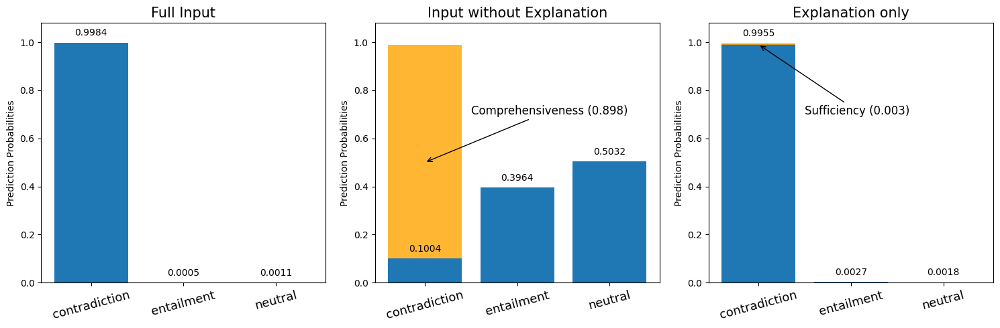

In [37]:
import matplotlib.pyplot as plt

#plt.rcParams.update({'font.size': 10})

# Create subplots
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Common order for labels
common_labels = ['contradiction', 'entailment', 'neutral']

# Function to add labels
def add_labels(ax, labels, scores):
    for i, score in enumerate(scores):
        ax.text(i, score + 0.02, round(score, 4), ha='center', va='bottom')

# Function to plot bars in common order
def plot_bars(ax, title, data, add_extra_bar=False, annotation_text=None, height=None):
    ordered_scores = [data['scores'][data['labels'].index(label)] if label in data['labels'] else 0 for label in common_labels]
    ax.bar(common_labels, ordered_scores)
    ax.set_title(title, fontsize=15)
    ax.set_ylabel('Prediction Probabilities')
    ax.set_ylim([0, 1.08])
    add_labels(ax, common_labels, ordered_scores)
    ax.tick_params(axis='x', rotation=15, labelsize=13)
    
    if add_extra_bar:
        contradiction_index = common_labels.index('contradiction')
        original_height = ordered_scores[contradiction_index]
        additional_height = 0.99 - original_height
        ax.bar(common_labels[contradiction_index], additional_height, color='orange', alpha=0.8, bottom=original_height)
        
        if annotation_text:
            ax.annotate(annotation_text, xy=(contradiction_index, height), xytext=(contradiction_index + 0.5, 0.7),
                        arrowprops=dict(facecolor='black', arrowstyle='->'), fontsize=12)

# Plot for pred_full, pred_comp, pred_suff
plot_bars(axs[0], 'Full Input', pred_full)
plot_bars(axs[1], 'Input without Explanation', pred_comp, add_extra_bar=True, annotation_text='Comprehensiveness (0.898)', height=0.5)
plot_bars(axs[2], 'Explanation only', pred_suff, add_extra_bar=True, annotation_text='Sufficiency (0.003)', height=0.99)

plt.tight_layout()
plt.show()


## Plausiblity

In [213]:
sample_ground_truth = dataset_esnli_full['extractive_explanation'][index]
sample_explanation_tokens = explainer_nli.get_explanation_list([sample_explanation], top_k=None, top_percent=avg_len_esnli)[0] # avg_len_cose = 0.19

import string 

def remove_punctuation(explanation_tokens, ground_truth):
    ground_truth = [word.translate(str.maketrans('', '', string.punctuation)) for word in ground_truth]
    explanation_tokens = [word.translate(str.maketrans('', '', string.punctuation)) for word in explanation_tokens]
    return ground_truth, explanation_tokens

sample_ground_truth, sample_explanation_tokens = remove_punctuation(sample_explanation_tokens, sample_ground_truth)

print('ground truth explanation: ', sample_ground_truth)
print('LIME explanation: ', sample_explanation_tokens)

iou_example = explainer_nli.compute_instance_iou(sample_explanation_tokens, sample_ground_truth)
tokenf1_example = explainer_nli.compute_instance_f1(sample_explanation_tokens, sample_ground_truth)

print('iou_example: ', iou_example)
print('tokenf1_example: ', tokenf1_example)



ground truth explanation:  ['sitting', 'standing']
LIME explanation:  ['sitting', 'all', 'standing']
iou_example:  0.6666666666666666
tokenf1_example:  0.8


In [218]:
html_explanation = sample_explanation.as_html(labels = [sample_explanation.top_labels[0]])
# Save the HTML to a file
with open('results/html_explanation_esnli.html', 'w') as f:
    f.write(html_explanation)

# CoS-e

In [42]:
index = 14

xsmall_zsc.get_results([dataset_cose_full['question'][index]], candidate_labels_list=[dataset_cose_full['choices'][index]])


[{'sequence': 'Bob the lizard lives in a warm place with lots of water.  Where does he probably live?',
  'labels': ['tropical rainforest',
   'new mexico',
   'rocky places',
   'rock',
   'jazz club'],
  'scores': [0.5291531085968018,
   0.13663837313652039,
   0.1346750259399414,
   0.10020430386066437,
   0.09932920336723328]}]

In [43]:
correct = results['cose']['xsmall']['correct_idx']
print(correct)


[4, 5, 14, 17, 18, 22, 23, 24, 25, 29, 33, 38, 39, 41, 46, 47, 49, 51, 52, 54, 60, 65, 66, 67, 71, 72, 76, 77, 81, 83, 85, 86, 87, 89, 93, 95, 98, 99, 100, 101, 102, 103, 107, 109, 122, 124, 125, 143, 145, 146, 157, 159, 160, 164, 165, 166, 167, 169, 170, 171, 172, 173, 174, 175, 178, 181, 183, 186, 188, 189, 190, 191, 192, 194, 198, 199, 203, 209, 211, 215, 219, 221, 222, 223, 225, 229, 232, 233, 238, 247, 253, 264, 266, 267, 269, 273, 274, 279, 287, 288, 291, 292, 296, 298, 306, 312, 313, 314, 323, 325, 329, 330, 331, 332, 334, 339, 344, 345, 346, 350, 352, 354, 358, 359, 360, 361, 363, 369, 376, 377, 379, 383, 386, 387, 388, 390, 393, 398, 403, 407, 409, 413, 415, 418, 423, 424, 425, 428, 429, 433, 448, 449, 452, 455, 459, 460, 469, 471, 481, 482, 487, 488, 489, 491, 496, 497, 500, 501, 505, 508, 513, 514, 515, 520, 523, 526, 527, 529, 530, 531, 538, 539, 541, 543, 544, 545, 548, 553, 558, 561, 562, 563, 565, 567, 569, 570, 571, 579, 580, 582, 585, 590, 592, 593, 599, 601, 604, 606,

In [44]:
index = 14

xsmall_zsc.get_results([dataset_cose_full['question'][index]], candidate_labels_list=[dataset_cose_full['choices'][index]])


[{'sequence': 'Bob the lizard lives in a warm place with lots of water.  Where does he probably live?',
  'labels': ['tropical rainforest',
   'new mexico',
   'rocky places',
   'rock',
   'jazz club'],
  'scores': [0.5291531085968018,
   0.13663837313652039,
   0.1346750259399414,
   0.10020430386066437,
   0.09932920336723328]}]

In [45]:
sample_explanation = explainer_zsc.compute_explanations(
   sentences = [dataset_cose_full['question'][index]],
   model=xsmall_zsc,
   num_samples=100,
   class_names_list=[dataset_cose_full['candidate_labels_list'][index]]
   )[0]



In [46]:
explainer_zsc.show_lime([sample_explanation])

----------------------------------------------------------------------------------------------------


In [47]:
sample_comprehensiveness = explainer_zsc.comprehensiveness(
        explanation=sample_explanation, 
        sentence=dataset_cose_full['question'][index], 
        predict=xsmall_zsc.predict, 
        #top_k=10,
        top_percent=0.1,
        verbose=True,
        task='ZSC',
        candidate_labels=dataset_cose_full['candidate_labels_list'][index]
        )

explanation_tokens:  ['water.', 'lizard']
sentence_old:  Bob the lizard lives in a warm place with lots of water.  Where does he probably live?
sentence_new:  Bob the lives in a warm place with lots of Where does he probably live?
probability_old:  0.5291531085968018
predicted_label_old:  tropical rainforest
probability_new:  0.09274578094482422
predicted_label_new:  rock
comprehensiveness:  0.43640732765197754 



In [48]:
sample_sufficiency = explainer_zsc.sufficiency(
        explanation=sample_explanation, 
        sentence=dataset_cose_full['question'][index], 
        predict=xsmall_zsc.predict, 
        #top_k=10,
        top_percent=0.1,
        verbose=True,
        task='ZSC',
        candidate_labels=dataset_cose_full['candidate_labels_list'][index]
        )

explanation_tokens:  ['water.', 'lizard']
sentence_old:  Bob the lizard lives in a warm place with lots of water.  Where does he probably live?
sentence_new:  lizard water.
probability_old:  0.5291531085968018
predicted_label_old:  tropical rainforest
probability_new:  0.23010560870170593
predicted_label_new:  rocky places
sufficiency:  0.2990474998950958 



In [49]:
#Full sentence
pred_full = xsmall_zsc.get_results(['Bob the lizard lives in a warm place with lots of water.  Where does he probably live?'], [dataset_cose_full['candidate_labels_list'][index]])
pred_full

[{'sequence': 'Bob the lizard lives in a warm place with lots of water.  Where does he probably live?',
  'labels': ['tropical rainforest',
   'new mexico',
   'rocky places',
   'rock',
   'jazz club'],
  'scores': [0.5291531085968018,
   0.13663837313652039,
   0.1346750259399414,
   0.10020430386066437,
   0.09932920336723328]}]

In [50]:
# Comprehensivness
pred_comp = xsmall_zsc.get_results(['Bob the lives in a warm place with lots of Where does he probably live?'], [dataset_cose_full['candidate_labels_list'][index]])
pred_comp

[{'sequence': 'Bob the lives in a warm place with lots of Where does he probably live?',
  'labels': ['rock',
   'jazz club',
   'rocky places',
   'new mexico',
   'tropical rainforest'],
  'scores': [0.29937827587127686,
   0.2651849389076233,
   0.23095884919166565,
   0.11173221468925476,
   0.09274578094482422]}]

In [51]:
# Sufficiency
pred_suff = xsmall_zsc.get_results(['lizard water.'], [dataset_cose_full['candidate_labels_list'][index]])
pred_suff

[{'sequence': 'lizard water.',
  'labels': ['rocky places',
   'tropical rainforest',
   'rock',
   'jazz club',
   'new mexico'],
  'scores': [0.30186864733695984,
   0.23010560870170593,
   0.1894552856683731,
   0.17671291530132294,
   0.1018575057387352]}]

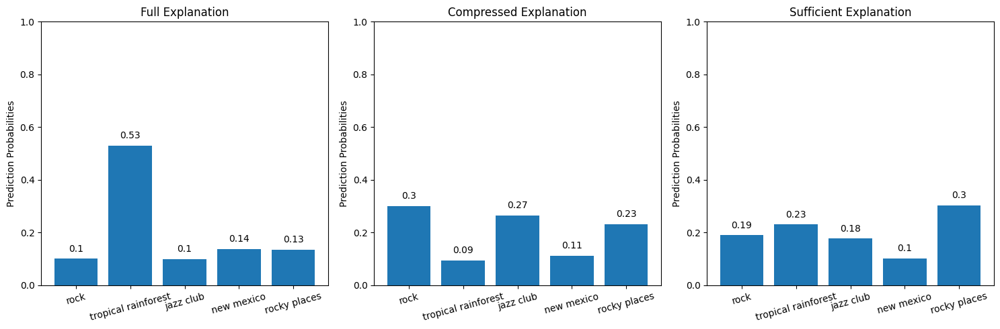

In [52]:
import matplotlib.pyplot as plt

# Create subplots
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Common order for labels
common_labels = ['rock', 'tropical rainforest', 'jazz club', 'new mexico', 'rocky places']

# Function to add labels
def add_labels(ax, labels, scores):
    for i, score in enumerate(scores):
        ax.text(i, score + 0.02, round(score, 2), ha='center', va='bottom')

# Function to plot bars in common order
def plot_bars(ax, title, data):
    ordered_scores = [data['scores'][data['labels'].index(label)] if label in data['labels'] else 0 for label in common_labels]
    ax.bar(common_labels, ordered_scores)
    ax.set_title(title)
    ax.set_ylabel('Prediction Probabilities')
    ax.set_ylim([0, 1])
    add_labels(ax, common_labels, ordered_scores)
    ax.tick_params(axis='x', rotation=15)

# Plot for pred_full, pred_comp, pred_suff
plot_bars(axs[0], 'Full Explanation', pred_full[0])
plot_bars(axs[1], 'Compressed Explanation', pred_comp[0])
plot_bars(axs[2], 'Sufficient Explanation', pred_suff[0])

plt.tight_layout()
plt.show()

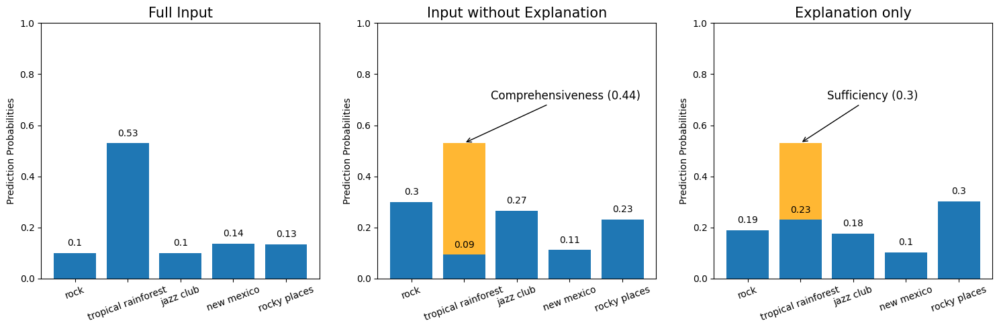

In [58]:
import matplotlib.pyplot as plt

#plt.rcParams.update({'font.size': 10})

# Create subplots
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Common order for labels
common_labels = ['rock', 'tropical rainforest', 'jazz club', 'new mexico', 'rocky places']

# Function to add labels
def add_labels(ax, labels, scores):
    for i, score in enumerate(scores):
        ax.text(i, score + 0.02, round(score, 2), ha='center', va='bottom')

# Function to plot bars in common order
def plot_bars(ax, title, data, add_extra_bar=False, annotation_text=None):
    ordered_scores = [data['scores'][data['labels'].index(label)] if label in data['labels'] else 0 for label in common_labels]
    ax.bar(common_labels, ordered_scores)
    ax.set_title(title, fontsize=15)
    ax.set_ylabel('Prediction Probabilities')
    ax.set_ylim([0, 1])
    add_labels(ax, common_labels, ordered_scores)
    ax.tick_params(axis='x', rotation=20, labelsize=10)
    
    if add_extra_bar:
        tropical_rainforest_index = common_labels.index('tropical rainforest')
        original_height = ordered_scores[tropical_rainforest_index]
        additional_height = 0.53 - original_height
        ax.bar(common_labels[tropical_rainforest_index], additional_height, color='orange', alpha=0.8, bottom=original_height)
        
        if annotation_text:
            ax.annotate(annotation_text, xy=(tropical_rainforest_index, 0.53), xytext=(tropical_rainforest_index + 0.5, 0.7),
                        arrowprops=dict(facecolor='black', arrowstyle='->'), fontsize=12)

# Plot for pred_full, pred_comp, pred_suff
plot_bars(axs[0], 'Full Input', pred_full[0])
plot_bars(axs[1], 'Input without Explanation', pred_comp[0], add_extra_bar=True, annotation_text='Comprehensiveness (0.44)')
plot_bars(axs[2], 'Explanation only', pred_suff[0], add_extra_bar=True, annotation_text='Sufficiency (0.3)')

plt.tight_layout()
plt.show()


# Plausibilty

In [31]:
sample_ground_truth = dataset_cose_full['extractive_explanation'][index]
sample_explanation_tokens = explainer_zsc.get_explanation_list([sample_explanation], top_k=None, top_percent=avg_len_cose)[0] # avg_len_cose = 0.26

import string 

def remove_punctuation(explanation_tokens, ground_truth):
    ground_truth = [word.translate(str.maketrans('', '', string.punctuation)) for word in ground_truth]
    explanation_tokens = [word.translate(str.maketrans('', '', string.punctuation)) for word in explanation_tokens]
    return ground_truth, explanation_tokens

sample_ground_truth, sample_explanation_tokens = remove_punctuation(sample_explanation_tokens, sample_ground_truth)

print('ground truth explanation: ', sample_ground_truth)
print('LIME explanation: ', sample_explanation_tokens)



ground truth explanation:  ['lots', 'of', 'water']
LIME explanation:  ['water', 'lizard', 'a', 'lives', 'of']


In [32]:
#iou = |{water, of}| / |{water, of, lots, lizard, a, lives}| = 0.33

#tp = |{water, of}| = 2
#fp = |{lizard, a, lives}| = 3
#fn = |{lots}| = 1
#percision = 2/5
#recall =  2/3
#f1 = (2*(2/5)*(2/3))/((2/5)+(2/3)) = 0.5


In [28]:
iou_example = explainer_zsc.compute_instance_iou(sample_explanation_tokens, sample_ground_truth)
tokenf1_example = explainer_zsc.compute_instance_f1(sample_explanation_tokens, sample_ground_truth)

print('iou_example: ', iou_example)
print('tokenf1_example: ', tokenf1_example)

iou_example:  0.3333333333333333
tokenf1_example:  0.5


In [72]:
dataset_cose_full['choices'][index]

['rock', 'tropical rainforest', 'jazz club', 'new mexico', 'rocky places']

In [52]:

html_explanation = sample_explanation.as_html(labels = [sample_explanation.top_labels[0]])
# Save the HTML to a file
with open('results/html_explanation.html', 'w') as f:
    f.write(html_explanation)